In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import chi2_contingency

<frozen importlib._bootstrap>:228: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject


# Some exploratory analysis

In [5]:
df = pd.read_csv("Food_Establishment_Inspection_Data.csv" , low_memory=False)

In [6]:
df.columns

Index(['Name', 'Program Identifier', 'Inspection Date', 'Description',
       'Address', 'City', 'Zip Code', 'Phone', 'Longitude', 'Latitude',
       'Inspection Business Name', 'Inspection Type', 'Inspection Score',
       'Inspection Result', 'Inspection Closed Business', 'Violation Type',
       'Violation Description', 'Violation Points', 'Business_ID',
       'Inspection_Serial_Num', 'Violation_Record_ID', 'Grade'],
      dtype='object')

In [3]:
df_cleaned = df[['Inspection Score' ,'Inspection Result' ,  'Inspection Closed Business' , 'Violation Type','Violation Points',"Grade"]]

In [4]:
df_cleaned

,Inspection Score,Inspection Result,Inspection Closed Business,Violation Type,Violation Points,Grade
0,10.0,Unsatisfactory,False,BLUE,5,1.0
1,10.0,Unsatisfactory,False,RED,5,1.0
2,0.0,Satisfactory,False,NaN,0,1.0
3,0.0,Satisfactory,False,NaN,0,1.0
4,0.0,Satisfactory,False,NaN,0,2.0
...,...,...,...,...,...,...
250753,0.0,Complete,False,NaN,0,2.0
250754,0.0,Satisfactory,False,NaN,0,2.0
250755,0.0,Satisfactory,False,NaN,0,2.0
250756,0.0,Complete,False,NaN,0,2.0


<AxesSubplot:xlabel='Violation Type', ylabel='Violation Points'>

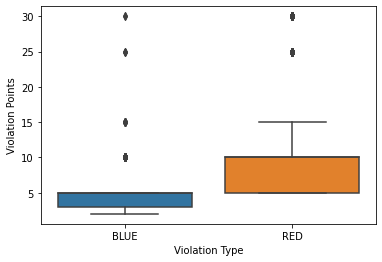

In [18]:
sns.boxplot(data= df_cleaned , x = "Violation Type" , y = "Violation Points")

<AxesSubplot:xlabel='Violation Points', ylabel='Inspection Result'>

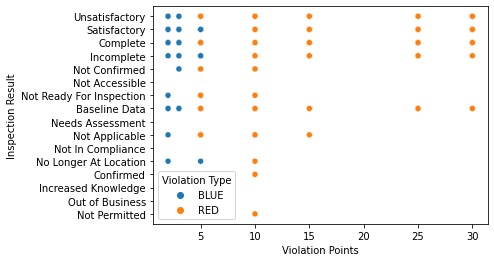

In [22]:
sns.scatterplot(data= df_cleaned , x = "Violation Points" , y = "Inspection Result", hue = "Violation Type")

In [5]:
df_cleaned.corr()

,Inspection Score,Violation Points,Grade
Inspection Score,1.000000,0.591614,0.291949
Violation Points,0.591614,1.000000,0.161187
Grade,0.291949,0.161187,1.000000


In [6]:
df_cleaned.describe()

,Inspection Score,Violation Points,Grade
count,249952.000000,250758.000000,191184.000000
mean,14.137182,4.408805,1.381611
std,20.281002,6.159414,0.579045
min,-30.000000,0.000000,1.000000
25%,0.000000,0.000000,1.000000
50%,5.000000,3.000000,1.000000
75%,20.000000,5.000000,2.000000
max,178.000000,30.000000,4.000000


In [31]:
df_cleaned["City"].nunique()

91

In [25]:
df_cleaned["City"].unique()

array(['SEATTLE', 'RENTON', 'REDMOND', 'KENT', 'BELLEVUE', 'KENMORE',
       'Seattle', 'ISSAQUAH', 'Bellevue', 'WOODINVILLE', 'KIRKLAND',
       'Kent', 'DES MOINES', 'BURIEN', 'Renton', 'Woodinville',
       'MAPLE VALLEY', 'AUBURN', 'Kirkland', 'Bothell', 'FEDERAL WAY',
       'TUKWILA', 'Auburn', 'ENUMCLAW', 'SHORELINE', 'Redmond',
       'Federal Way', 'BLACK DIAMOND', 'SNOQUALMIE', 'LAKE FOREST PARK',
       'COVINGTON', 'SAMMAMISH', 'MERCER ISLAND', 'NORTH BEND', 'DUVALL',
       'Shoreline', 'NEWCASTLE', 'BOTHELL', 'SEA TAC', 'VASHON ISLAND',
       'SEATAC', 'Pacific', 'PACIFIC', 'Mercer Island', 'Burien',
       'North Bend', 'NORMANDY PARK', 'Issaquah', 'FALL CITY',
       'SNOQUALMIE PASS', 'seattle', 'BUCKLEY', 'CLYDE HILL', 'SNOHOMISH',
       'Black Diamond', 'Carnation', 'CARNATION', 'Des Moines',
       'Enumclaw', 'Duvall', 'Vashon', 'ALGONA', 'BELLINGHAM',
       'Skykomish', 'Maple Valley', 'Fall City', 'TACOMA', 'Tukwila',
       'LYNNWOOD', 'PUYALLUP', 'Snoqualmie

In [27]:
df_cleaned["City"].value_counts()

SEATTLE        74068
Seattle        45308
BELLEVUE       12276
KENT            9750
FEDERAL WAY     8314
               ...  
BUCKLEY            2
Seatac             2
PARKLAND           1
BELLINGHAM         1
North BEnd         1
Name: City, Length: 91, dtype: int64

In [30]:
df_cleaned["Grade"].unique()

array([ 1.,  2., nan,  3.,  4.])

In [32]:
df_cleaned["Inspection Result"].unique()

array(['Unsatisfactory', 'Satisfactory', nan, 'Complete', 'Incomplete',
       'Not Confirmed', 'Not Accessible', 'Not Ready For Inspection',
       'Baseline Data', 'Needs Assessment', 'Not Applicable',
       'Not In Compliance', 'No Longer At Location', 'Confirmed',
       'Increased Knowledge', 'Out of Business', 'Not Permitted',
       'In Compliance', 'Not Tested'], dtype=object)

In [33]:
df_cleaned["Inspection Result"].nunique()

18

In [34]:
df_cleaned["Violation Points"].unique()

array([ 5,  0,  2, 25, 10,  3, 15, 30], dtype=int64)

In [35]:
df_cleaned["Inspection Score"].unique()

array([ 10.,   0.,  47.,  nan,  25.,  20.,   5.,  32.,  70.,  15.,  33.,
        45.,  30.,  18.,  13.,  35.,  38.,  23.,  12.,  55.,  40.,  48.,
       100.,  17.,  37.,  41.,   7.,   8.,  28.,   6.,  56.,  43.,   2.,
        53.,   3.,  63.,  73.,  26.,  50.,  21.,  65.,  36.,  58.,  68.,
        22.,  19.,  16.,  27.,  67.,  80.,  42.,  57.,  39.,  60.,   4.,
        75.,  90.,  85.,  24.,  11.,  51.,  34.,   9.,  31.,  52.,  88.,
        92.,  64.,  46.,  77.,  95.,  83.,  78., 125., 110., 105.,  66.,
        71., 121.,  93.,  86.,  96., 113.,  44., 115.,  91., 135., 152.,
        62.,  81.,  29.,  49., 133.,  99.,  79., 128.,  54.,  89., 104.,
        76.,  61.,  87., 101., 106., 103.,  98.,  82., 108.,  -1.,  72.,
       129.,  59., 119., 123.,  14.,  84., 114., 111., 107., 126., 132.,
       118., 178., 146., 136., 130.,  -2., 112., 102.,  69.,  74., 140.,
       143., 149., 109., 120., -30., 139., 131., 141.])

In [37]:
df_cleaned["Inspection Type"].unique()

array(['Routine Inspection/Field Review', 'Return Inspection',
       'Consultation/Education - Field', nan], dtype=object)

<AxesSubplot:xlabel='Grade', ylabel='Count'>

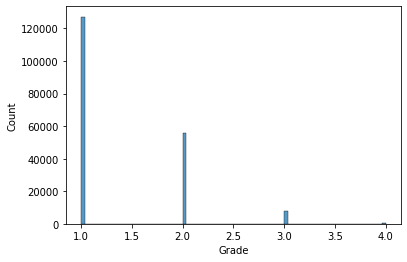

In [38]:
sns.histplot(data= df_cleaned , x = "Grade")

<AxesSubplot:xlabel='Violation Points', ylabel='Count'>

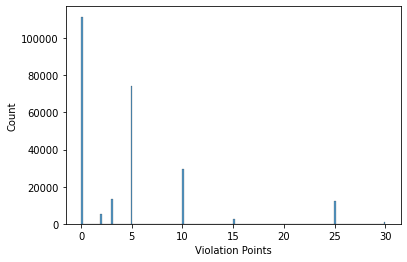

In [40]:
sns.histplot(data= df_cleaned , x = "Violation Points")

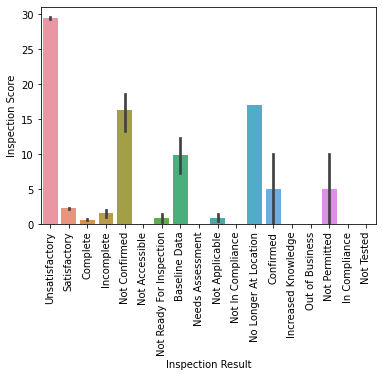

In [9]:
ax = sns.barplot(data=df_cleaned , x = "Inspection Result" , y= "Inspection Score")
ax.tick_params(axis='x', rotation=90)

In [7]:
df.columns

Index(['Name', 'Program Identifier', 'Inspection Date', 'Description',
       'Address', 'City', 'Zip Code', 'Phone', 'Longitude', 'Latitude',
       'Inspection Business Name', 'Inspection Type', 'Inspection Score',
       'Inspection Result', 'Inspection Closed Business', 'Violation Type',
       'Violation Description', 'Violation Points', 'Business_ID',
       'Inspection_Serial_Num', 'Violation_Record_ID', 'Grade'],
      dtype='object')

In [1]:
import plotly.express as px

In [9]:
fig = px.scatter_mapbox(df, 
                        lat="Latitude", 
                        lon="Longitude", 
                        hover_name="Address",
                        zoom=8, 
                        height=800,
                        width=800)

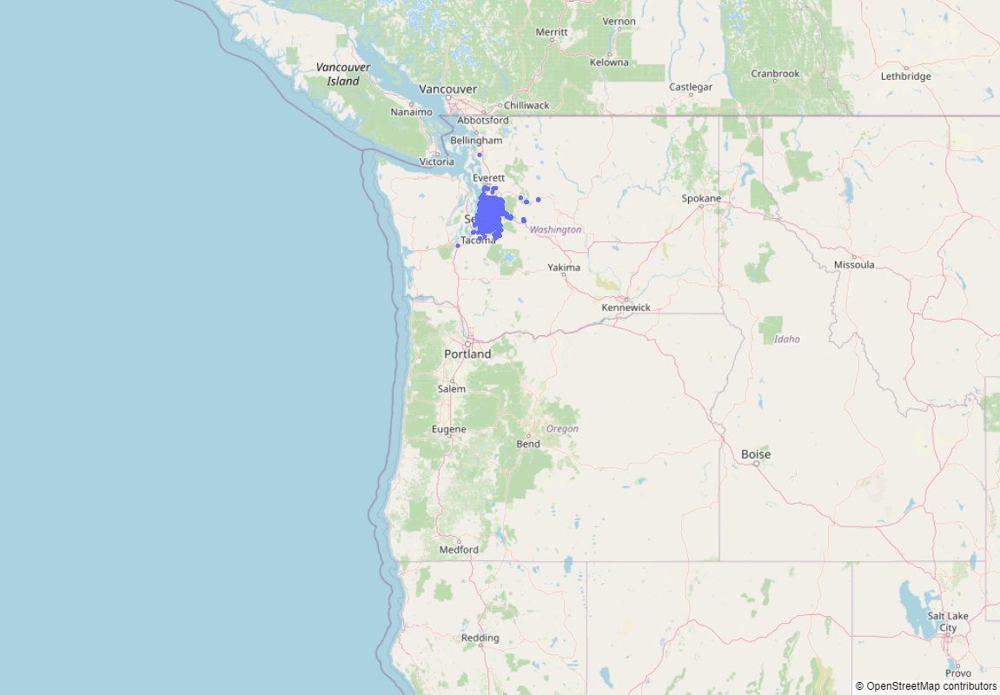

In [10]:
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [17]:
df.head(3)

,Name,Program Identifier,Inspection Date,Description,Address,City,Zip Code,Phone,Longitude,Latitude,...,Inspection Score,Inspection Result,Inspection Closed Business,Violation Type,Violation Description,Violation Points,Business_ID,Inspection_Serial_Num,Violation_Record_ID,Grade
0,#807 TUTTA BELLA,#807 TUTTA BELLA,08/31/2022,Seating 0-12 - Risk Category III,2746 NE 45TH ST,SEATTLE,98105,(206) 722-6400,-122.296415,47.662311,...,10.0,Unsatisfactory,False,BLUE,"3200 - Insects, rodents, animals not present; ...",5,PR0089260,DAEEWQC0L,IVQ7QYW2V,1.0
1,#807 TUTTA BELLA,#807 TUTTA BELLA,08/31/2022,Seating 0-12 - Risk Category III,2746 NE 45TH ST,SEATTLE,98105,(206) 722-6400,-122.296415,47.662311,...,10.0,Unsatisfactory,False,RED,0200 - Food Worker Cards current for all food ...,5,PR0089260,DAEEWQC0L,IV0J437H6,1.0
2,#807 TUTTA BELLA,#807 TUTTA BELLA,01/13/2022,Seating 0-12 - Risk Category III,2746 NE 45TH ST,SEATTLE,98105,(206) 722-6400,-122.296415,47.662311,...,0.0,Satisfactory,False,NaN,NaN,0,PR0089260,DAWWGK08K,NaN,1.0


In [22]:
df.loc[0,"Inspection Score"]

10.0

In [16]:
df.columns

Index(['Name', 'Program Identifier', 'Inspection Date', 'Description',
       'Address', 'City', 'Zip Code', 'Phone', 'Longitude', 'Latitude',
       'Inspection Business Name', 'Inspection Type', 'Inspection Score',
       'Inspection Result', 'Inspection Closed Business', 'Violation Type',
       'Violation Description', 'Violation Points', 'Business_ID',
       'Inspection_Serial_Num', 'Violation_Record_ID', 'Grade'],
      dtype='object')

In [33]:
sum(df["Inspection Business Name"].isna())

765

In [34]:
sum(df["Inspection Type"].isna())

765

In [35]:
sum(df["Inspection Score"].isna())

806

In [36]:
sum(df["Inspection Result"].isna())

765

In [37]:
sum(df["Inspection Closed Business"].isna())

765

In [38]:
sum(df["Violation Type"].isna())

111623

In [39]:
sum(df["Violation Description"].isna())

111623

In [40]:
sum(df["Violation Points"].isna())

0

In [41]:
sum(df["Business_ID"].isna())

0

In [42]:
sum(df["Inspection_Serial_Num"].isna())

765

In [43]:
sum(df["Violation_Record_ID"].isna())

111623

In [44]:
sum(df["Grade"].isna())

59574

In [14]:
sum(df["Violation Points"].isna())

0

In [23]:
sum(df["Name"].isna())

0

In [24]:
sum(df["Program Identifier"].isna())

0

In [25]:
sum(df["Inspection Date"].isna())

765

In [26]:
sum(df["Description"].isna())

0

In [27]:
sum(df["Address"].isna())

0

In [28]:
sum(df["City"].isna())

0

In [29]:
sum(df["Zip Code"].isna())

0

In [30]:
sum(df["Phone"].isna())

71297

In [31]:
sum(df["Longitude"].isna())

324

In [32]:
sum(df["Latitude"].isna())

324

In [45]:
df.shape

(250758, 22)

In [46]:
df["City"].nunique()

91

In [47]:
df["City"].unique()

array(['SEATTLE', 'RENTON', 'REDMOND', 'KENT', 'BELLEVUE', 'KENMORE',
       'Seattle', 'ISSAQUAH', 'Bellevue', 'WOODINVILLE', 'KIRKLAND',
       'Kent', 'DES MOINES', 'BURIEN', 'Renton', 'Woodinville',
       'MAPLE VALLEY', 'AUBURN', 'Kirkland', 'Bothell', 'FEDERAL WAY',
       'TUKWILA', 'Auburn', 'ENUMCLAW', 'SHORELINE', 'Redmond',
       'Federal Way', 'BLACK DIAMOND', 'SNOQUALMIE', 'LAKE FOREST PARK',
       'COVINGTON', 'SAMMAMISH', 'MERCER ISLAND', 'NORTH BEND', 'DUVALL',
       'Shoreline', 'NEWCASTLE', 'BOTHELL', 'SEA TAC', 'VASHON ISLAND',
       'SEATAC', 'Pacific', 'PACIFIC', 'Mercer Island', 'Burien',
       'North Bend', 'NORMANDY PARK', 'Issaquah', 'FALL CITY',
       'SNOQUALMIE PASS', 'seattle', 'BUCKLEY', 'CLYDE HILL', 'SNOHOMISH',
       'Black Diamond', 'Carnation', 'CARNATION', 'Des Moines',
       'Enumclaw', 'Duvall', 'Vashon', 'ALGONA', 'BELLINGHAM',
       'Skykomish', 'Maple Valley', 'Fall City', 'TACOMA', 'Tukwila',
       'LYNNWOOD', 'PUYALLUP', 'Snoqualmie

In [48]:
df["Inspection Type"].unique()

array(['Routine Inspection/Field Review', 'Return Inspection',
       'Consultation/Education - Field', nan], dtype=object)

In [49]:
df["Inspection Score"].unique()

array([ 10.,   0.,  47.,  nan,  25.,  20.,   5.,  32.,  70.,  15.,  33.,
        45.,  30.,  18.,  13.,  35.,  38.,  23.,  12.,  55.,  40.,  48.,
       100.,  17.,  37.,  41.,   7.,   8.,  28.,   6.,  56.,  43.,   2.,
        53.,   3.,  63.,  73.,  26.,  50.,  21.,  65.,  36.,  58.,  68.,
        22.,  19.,  16.,  27.,  67.,  80.,  42.,  57.,  39.,  60.,   4.,
        75.,  90.,  85.,  24.,  11.,  51.,  34.,   9.,  31.,  52.,  88.,
        92.,  64.,  46.,  77.,  95.,  83.,  78., 125., 110., 105.,  66.,
        71., 121.,  93.,  86.,  96., 113.,  44., 115.,  91., 135., 152.,
        62.,  81.,  29.,  49., 133.,  99.,  79., 128.,  54.,  89., 104.,
        76.,  61.,  87., 101., 106., 103.,  98.,  82., 108.,  -1.,  72.,
       129.,  59., 119., 123.,  14.,  84., 114., 111., 107., 126., 132.,
       118., 178., 146., 136., 130.,  -2., 112., 102.,  69.,  74., 140.,
       143., 149., 109., 120., -30., 139., 131., 141.])

In [58]:
df["Violation Description"].nunique()


146

In [59]:
df["Violation Points"].nunique()


8

In [60]:
df["Violation Points"].unique()


array([ 5,  0,  2, 25, 10,  3, 15, 30], dtype=int64)

In [63]:
df["Business_ID"].unique()


array(['PR0089260', 'PR0046367', 'PR0090156', ..., 'PR0046617',
       'PR0086991', 'PR0089412'], dtype=object)

In [64]:
df["Violation_Record_ID"].unique()


array(['IVQ7QYW2V', 'IV0J437H6', nan, ..., 'IVUQW8VFW', 'IVKOAHQV4',
       'IVFUOGTQ3'], dtype=object)

In [65]:
df["Violation_Record_ID"].nunique()


139135

In [66]:
sum(df["Violation_Record_ID"].isna())

111623

In [67]:
df["Inspection_Serial_Num"].nunique()


177125

In [69]:
sum(df["Inspection_Serial_Num"].isna())


765

In [70]:
df["Grade"].unique()

array([ 1.,  2., nan,  3.,  4.])

# Data Cleaning

In [2]:
df = pd.read_csv("Food_Establishment_Inspection_Data.csv" , low_memory=False)

In [3]:
df.head()

,Name,Program Identifier,Inspection Date,Description,Address,City,Zip Code,Phone,Longitude,Latitude,...,Inspection Score,Inspection Result,Inspection Closed Business,Violation Type,Violation Description,Violation Points,Business_ID,Inspection_Serial_Num,Violation_Record_ID,Grade
0,#807 TUTTA BELLA,#807 TUTTA BELLA,08/31/2022,Seating 0-12 - Risk Category III,2746 NE 45TH ST,SEATTLE,98105,(206) 722-6400,-122.296415,47.662311,...,10.0,Unsatisfactory,False,BLUE,"3200 - Insects, rodents, animals not present; ...",5,PR0089260,DAEEWQC0L,IVQ7QYW2V,1.0
1,#807 TUTTA BELLA,#807 TUTTA BELLA,08/31/2022,Seating 0-12 - Risk Category III,2746 NE 45TH ST,SEATTLE,98105,(206) 722-6400,-122.296415,47.662311,...,10.0,Unsatisfactory,False,RED,0200 - Food Worker Cards current for all food ...,5,PR0089260,DAEEWQC0L,IV0J437H6,1.0
2,#807 TUTTA BELLA,#807 TUTTA BELLA,01/13/2022,Seating 0-12 - Risk Category III,2746 NE 45TH ST,SEATTLE,98105,(206) 722-6400,-122.296415,47.662311,...,0.0,Satisfactory,False,NaN,NaN,0,PR0089260,DAWWGK08K,NaN,1.0
3,#807 TUTTA BELLA,#807 TUTTA BELLA,01/06/2021,Seating 0-12 - Risk Category III,2746 NE 45TH ST,SEATTLE,98105,(206) 722-6400,-122.296415,47.662311,...,0.0,Satisfactory,False,NaN,NaN,0,PR0089260,DAUHM2FT8,NaN,1.0
4,+MAS CAFE,+MAS CAFE,07/13/2022,Seating 0-12 - Risk Category III,1906 N 34TH ST,SEATTLE,98103,(206) 491-4694,-122.334587,47.648180,...,0.0,Satisfactory,False,NaN,NaN,0,PR0046367,DATSWIPUS,NaN,2.0


## Dropping rows/columns

In [4]:
missing_values = {}
for col in df:
    missing_values[col] = sum(df[col].isna())

In [5]:
# plt.figure(figsize=(5,5))
# plt.bar(missing_values.keys(), missing_values.values())
# plt.xticks(rotation = 90);
# plt.savefig("missing_data.jpg",bbox_inches = "tight")

In [6]:
df[df["Inspection Date"].isna()]

,Name,Program Identifier,Inspection Date,Description,Address,City,Zip Code,Phone,Longitude,Latitude,...,Inspection Score,Inspection Result,Inspection Closed Business,Violation Type,Violation Description,Violation Points,Business_ID,Inspection_Serial_Num,Violation_Record_ID,Grade
12,?al?al Cafe,?al?al Cafe,NaN,Seating 13-50 - Risk Category III,122 2nd AVE S,SEATTLE,98104,(952) 649-8629,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0,PR0090156,NaN,NaN,NaN
406,203 DEGREES FAHRENHEIT CORP,203 DEGREES FAHRENHEIT CORP,NaN,Seating 13-50 - Risk Category II,610 TERRY AVE N STE 170,SEATTLE,98109,(206) 227-4293,-122.336833,47.625299,...,NaN,NaN,NaN,NaN,NaN,0,PR0090075,NaN,NaN,NaN
552,3 BROS PIZZA CO,3 BROS PIZZA CO,NaN,Caterer - Risk Category II,5604 DELRIDGE WAY SW,SEATTLE,98106,(509) 881-5675,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0,PR0090517,NaN,NaN,NaN
564,3G MEALS LLC,3G MEALS LLC,NaN,Caterer - Risk Category III,960 HARRINGTON NE STE B,RENTON,98056,(425) 276-0395,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0,PR0090332,NaN,NaN,NaN
932,7-ELEVEN #17486N,7-ELEVEN #17486N,NaN,Seating 0-12 - Risk Category III,12702 RENTON AVE S,Seattle,98178,(972) 828-6865,-122.237924,47.490124,...,NaN,NaN,NaN,NaN,NaN,0,PR0005117,NaN,NaN,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
249034,YUMMI SUSHI @ QFC #829,YUMMI SUSHI @ QFC #829,NaN,Seating 0-12 - Risk Category III,460 E NORTH BEND WAY,NORTH BEND,98045,(469) 213-2595,-121.780660,47.493137,...,NaN,NaN,NaN,NaN,NaN,0,PR0071894,NaN,NaN,NaN
249271,YUMMY GYROS,YUMMY GYROS,NaN,Mobile Food Unit - Risk Category III,512 SE Ramsey WAY ST 106,KENT,98032,(253) 277-7570,-122.302546,47.608186,...,NaN,NaN,NaN,NaN,NaN,0,PR0082076,NaN,NaN,NaN
249474,YUMMY TERIYAKI,YUMMY TERIYAKI,NaN,Seating 13-50 - Risk Category III,17218 REDMOND WAY,REDMOND,98052,(206) 372-5222,-122.109906,47.672520,...,NaN,NaN,NaN,NaN,NaN,0,PR0064421,NaN,NaN,NaN
250522,ZHEN KEE RESTAURANT,ZHEN KEE RESTAURANT,NaN,Seating 0-12 - Risk Category III,3640 128TH AVE SE,BELLEVUE,98006,(206) 356-9526,-122.167279,47.577678,...,NaN,NaN,NaN,NaN,NaN,0,PR0030232,NaN,NaN,NaN


In [7]:
df_cleaned = df.drop(df[df["Inspection Date"].isna()].index , axis=0)

In [8]:
missing_values_cleaned = {}
for col in df_cleaned:
    missing_values_cleaned[col] = sum(df_cleaned[col].isna())

In [9]:
missing_values_cleaned

{'Name': 0,
 'Program Identifier': 0,
 'Inspection Date': 0,
 'Description': 0,
 'Address': 0,
 'City': 0,
 'Zip Code': 0,
 'Phone': 71269,
 'Longitude': 161,
 'Latitude': 161,
 'Inspection Business Name': 0,
 'Inspection Type': 0,
 'Inspection Score': 41,
 'Inspection Result': 0,
 'Inspection Closed Business': 0,
 'Violation Type': 110858,
 'Violation Description': 110858,
 'Violation Points': 0,
 'Business_ID': 0,
 'Inspection_Serial_Num': 0,
 'Violation_Record_ID': 110858,
 'Grade': 58955}

In [10]:
# plt.figure(figsize=(5,5))
# plt.bar(missing_values_cleaned.keys(), missing_values_cleaned.values())
# plt.xticks(rotation = 90);
# plt.savefig("missing_data_cleaned.jpg",bbox_inches = "tight")

In [11]:
df_cleaned.drop(["Phone" , "Violation_Record_ID"],axis=1,inplace=True)

## Filling missing data

### Fill Inspection Score missing values

In [12]:
df_cleaned[df_cleaned["Inspection Score"].isna()].head()

,Name,Program Identifier,Inspection Date,Description,Address,City,Zip Code,Longitude,Latitude,Inspection Business Name,Inspection Type,Inspection Score,Inspection Result,Inspection Closed Business,Violation Type,Violation Description,Violation Points,Business_ID,Inspection_Serial_Num,Grade
10743,ANTHONY'S HOME PORT,ANTHONY'S HOME PORT,10/06/2008,Seating > 250 - Risk Category III,135 LAKE ST S,Kirkland,98033,-122.206124,47.674172,ANTHONY'S HOME PORT,Routine Inspection/Field Review,NaN,Satisfactory,False,NaN,NaN,0,PR0006074,DA1904280,1.0
14148,ATHENIAN INN,ATHENIAN INN,06/26/2007,Seating 151-250 - Risk Category III,1517 PIKE PL,SEATTLE,98101,-122.340882,47.608694,ATHENIAN INN,Consultation/Education - Field,NaN,Complete,False,NaN,NaN,0,PR0002320,DA1705027,2.0
22769,BETHEL CHRISTIAN CENTER,BETHEL CHRISTIAN CENTER,05/05/2008,Non-Profit Institution - Risk Category III,414 SW 312TH ST,FEDERAL WAY,98023,-122.341099,47.323437,BETHEL CHRISTIAN CENTER,Consultation/Education - Field,NaN,Complete,False,NaN,NaN,0,PR0071099,DA1839240,NaN
29344,BRYANT ELEMENTARY SCHOOL,BRYANT ELEMENTARY SCHOOL,10/06/2008,School Lunch Program - Risk II,3311 NE 60TH ST,Seattle,98105,-122.292005,47.671515,BRYANT ELEMENTARY SCHOOL,Routine Inspection/Field Review,NaN,Satisfactory,False,NaN,NaN,0,PR0001161,DA1905255,NaN
38862,CHAUTAUQUA ELEMENTARY,CHAUTAUQUA ELEMENTARY,03/26/2007,School Lunch Program - Risk II,9309 SW CEMETERY RD,VASHON ISLAND,98070,-122.452360,47.427607,CHAUTAUQUA ELEMENTARY,Routine Inspection/Field Review,NaN,Satisfactory,False,NaN,NaN,0,PR0034359,DA1665247,NaN


In [13]:
look_up = df_cleaned.pivot_table(index="Inspection Closed Business" , columns="Inspection Result", values ="Inspection Score" ,aggfunc="mean" )

In [14]:
look_up

Inspection Result,Baseline Data,Complete,Confirmed,In Compliance,Incomplete,Increased Knowledge,Needs Assessment,No Longer At Location,Not Accessible,Not Applicable,Not Confirmed,Not In Compliance,Not Permitted,Not Ready For Inspection,Not Tested,Out of Business,Satisfactory,Unsatisfactory
Inspection Closed Business,,,,,,,,,,,,,,,,,,
False,9.931373,0.586621,5.0,0.0,1.550139,0.0,0.0,17.0,0.0,0.887006,16.384615,0.0,5.0,0.868132,0.0,0.0,2.245258,29.03643
True,0.000000,131.157895,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,2.000000,96.46408


In [15]:
look_up.loc[True,"Complete"]

131.1578947368421

In [16]:
df_cleaned.loc[df_cleaned[df_cleaned["Inspection Score"].isna()].index,"Inspection Score"] = df_cleaned[df_cleaned["Inspection Score"].isna()].apply(lambda x :look_up.loc[x["Inspection Closed Business"],x["Inspection Result"]] , axis = 1)

In [17]:
df_cleaned["Inspection Score"].isna()

0         False
1         False
2         False
3         False
4         False
          ...  
250753    False
250754    False
250755    False
250756    False
250757    False
Name: Inspection Score, Length: 249993, dtype: bool

### Fill Violation Type missing values

In [18]:
df_cleaned.head()

,Name,Program Identifier,Inspection Date,Description,Address,City,Zip Code,Longitude,Latitude,Inspection Business Name,Inspection Type,Inspection Score,Inspection Result,Inspection Closed Business,Violation Type,Violation Description,Violation Points,Business_ID,Inspection_Serial_Num,Grade
0,#807 TUTTA BELLA,#807 TUTTA BELLA,08/31/2022,Seating 0-12 - Risk Category III,2746 NE 45TH ST,SEATTLE,98105,-122.296415,47.662311,#807 TUTTA BELLA,Routine Inspection/Field Review,10.0,Unsatisfactory,False,BLUE,"3200 - Insects, rodents, animals not present; ...",5,PR0089260,DAEEWQC0L,1.0
1,#807 TUTTA BELLA,#807 TUTTA BELLA,08/31/2022,Seating 0-12 - Risk Category III,2746 NE 45TH ST,SEATTLE,98105,-122.296415,47.662311,#807 TUTTA BELLA,Routine Inspection/Field Review,10.0,Unsatisfactory,False,RED,0200 - Food Worker Cards current for all food ...,5,PR0089260,DAEEWQC0L,1.0
2,#807 TUTTA BELLA,#807 TUTTA BELLA,01/13/2022,Seating 0-12 - Risk Category III,2746 NE 45TH ST,SEATTLE,98105,-122.296415,47.662311,#807 TUTTA BELLA,Routine Inspection/Field Review,0.0,Satisfactory,False,NaN,NaN,0,PR0089260,DAWWGK08K,1.0
3,#807 TUTTA BELLA,#807 TUTTA BELLA,01/06/2021,Seating 0-12 - Risk Category III,2746 NE 45TH ST,SEATTLE,98105,-122.296415,47.662311,#807 TUTTA BELLA,Routine Inspection/Field Review,0.0,Satisfactory,False,NaN,NaN,0,PR0089260,DAUHM2FT8,1.0
4,+MAS CAFE,+MAS CAFE,07/13/2022,Seating 0-12 - Risk Category III,1906 N 34TH ST,SEATTLE,98103,-122.334587,47.648180,+MAS CAFE,Return Inspection,0.0,Satisfactory,False,NaN,NaN,0,PR0046367,DATSWIPUS,2.0


In [19]:
df_cleaned.pivot_table(index=["Inspection Result","Inspection Closed Business"] , columns="Violation Type", aggfunc="size")
# No meaningful result

Violation Type                                          BLUE      RED
Inspection Result        Inspection Closed Business                  
Baseline Data            False                          24.0     23.0
Complete                 False                         225.0    371.0
                         True                            4.0     10.0
Confirmed                False                           NaN      1.0
Incomplete               False                          13.0     39.0
No Longer At Location    False                           2.0      1.0
Not Applicable           False                           3.0     10.0
Not Confirmed            False                           6.0      6.0
Not Permitted            False                           NaN      1.0
Not Ready For Inspection False                           3.0      7.0
Satisfactory             False                       26748.0    841.0
                         True                            3.0      NaN
Unsatisfactory           False                       38253.0  71856.0
                         True                          226.0    459.0

In [20]:
df_cleaned.pivot_table(index=["Inspection Result","Inspection Closed Business"] , columns="Violation Type",values = "Inspection Score" ,aggfunc="mean")
# No meaningful result

Violation Type                                             BLUE         RED
Inspection Result        Inspection Closed Business                        
Baseline Data            False                        16.583333   26.739130
Complete                 False                        27.824829   42.947673
                         True                        178.000000  178.000000
Confirmed                False                              NaN   10.000000
Incomplete               False                         9.461538   25.384615
No Longer At Location    False                        17.000000   17.000000
Not Applicable           False                        10.666667   12.500000
Not Confirmed            False                        17.000000   18.500000
Not Permitted            False                              NaN   10.000000
Not Ready For Inspection False                         6.333333    8.571429
Satisfactory             False                         7.747663   16.658740
                         True                          3.333333         NaN
Unsatisfactory           False                        30.907380   28.237783
                         True                        108.845133   92.679739

In [21]:
df_cleaned.pivot_table(index=["Inspection Result","Inspection Closed Business"] , columns="Violation Type",values = "Violation Points" ,aggfunc="mean")


Violation Type                                           BLUE        RED
Inspection Result        Inspection Closed Business                     
Baseline Data            False                       4.125000  11.739130
Complete                 False                       4.111111  13.059299
                         True                        4.500000  16.000000
Confirmed                False                            NaN  10.000000
Incomplete               False                       4.461538  14.102564
No Longer At Location    False                       3.500000  10.000000
Not Applicable           False                       4.000000   8.000000
Not Confirmed            False                       4.333333   7.500000
Not Permitted            False                            NaN  10.000000
Not Ready For Inspection False                       4.000000   6.428571
Satisfactory             False                       4.350082   9.910820
                         True                        3.333333        NaN
Unsatisfactory           False                       4.345280  11.135535
                         True                        4.269912  13.769063

<AxesSubplot:xlabel='Violation Type', ylabel='Violation Points'>

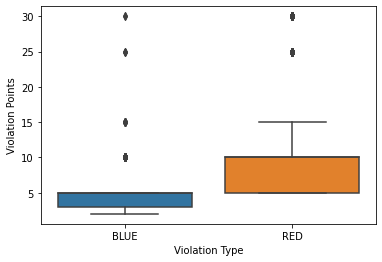

In [22]:
sns.boxplot(data=df_cleaned, x = "Violation Type" , y = "Violation Points")

In [23]:
## ^^^^ seems like 3rd quantile of violation points in blue group is 5
##  also 1st quantile of violation points in red group is 5
## so violation points beneath 5 are most likely Blue otherwise they are Red

In [24]:
np.percentile(df_cleaned[df_cleaned["Violation Type"] == "BLUE"]["Violation Points"],75)

5.0

In [25]:
np.percentile(df_cleaned[df_cleaned["Violation Type"] == "RED"]["Violation Points"],25)

5.0

In [26]:
df_cleaned.loc[df_cleaned[df_cleaned["Violation Type"].isna()].index,"Violation Type"] = df_cleaned[df_cleaned["Violation Type"].isna()]["Violation Points"].apply(lambda x : "RED" if x > 5 else "BLUE")

In [27]:
df_cleaned["Violation Type"] = df_cleaned["Violation Type"].map({"Blue" : "BLUE" , "RED" : "RED" , "BLUE" : "BLUE"})

### Check again for missing values

In [28]:
df_cleaned

,Name,Program Identifier,Inspection Date,Description,Address,City,Zip Code,Longitude,Latitude,Inspection Business Name,Inspection Type,Inspection Score,Inspection Result,Inspection Closed Business,Violation Type,Violation Description,Violation Points,Business_ID,Inspection_Serial_Num,Grade
0,#807 TUTTA BELLA,#807 TUTTA BELLA,08/31/2022,Seating 0-12 - Risk Category III,2746 NE 45TH ST,SEATTLE,98105,-122.296415,47.662311,#807 TUTTA BELLA,Routine Inspection/Field Review,10.0,Unsatisfactory,False,BLUE,"3200 - Insects, rodents, animals not present; ...",5,PR0089260,DAEEWQC0L,1.0
1,#807 TUTTA BELLA,#807 TUTTA BELLA,08/31/2022,Seating 0-12 - Risk Category III,2746 NE 45TH ST,SEATTLE,98105,-122.296415,47.662311,#807 TUTTA BELLA,Routine Inspection/Field Review,10.0,Unsatisfactory,False,RED,0200 - Food Worker Cards current for all food ...,5,PR0089260,DAEEWQC0L,1.0
2,#807 TUTTA BELLA,#807 TUTTA BELLA,01/13/2022,Seating 0-12 - Risk Category III,2746 NE 45TH ST,SEATTLE,98105,-122.296415,47.662311,#807 TUTTA BELLA,Routine Inspection/Field Review,0.0,Satisfactory,False,BLUE,NaN,0,PR0089260,DAWWGK08K,1.0
3,#807 TUTTA BELLA,#807 TUTTA BELLA,01/06/2021,Seating 0-12 - Risk Category III,2746 NE 45TH ST,SEATTLE,98105,-122.296415,47.662311,#807 TUTTA BELLA,Routine Inspection/Field Review,0.0,Satisfactory,False,BLUE,NaN,0,PR0089260,DAUHM2FT8,1.0
4,+MAS CAFE,+MAS CAFE,07/13/2022,Seating 0-12 - Risk Category III,1906 N 34TH ST,SEATTLE,98103,-122.334587,47.648180,+MAS CAFE,Return Inspection,0.0,Satisfactory,False,BLUE,NaN,0,PR0046367,DATSWIPUS,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
250753,ZYLBERSCHTEIN'S DELICATESSEN & BAKERY,ZYLBERSCHTEIN'S DELICATESSEN & BAKERY,11/21/2018,Seating 0-12 - Risk Category III,11752 15TH AVE NE,SEATTLE,98125,-122.312056,47.715359,ZYLBERSCHTEIN'S DELICATESSEN & BAKERY,Consultation/Education - Field,0.0,Complete,False,BLUE,NaN,0,PR0086991,DAJ0G4RNT,2.0
250754,ZYLBERSCHTEIN'S DELICATESSEN & BAKERY,ZYLBERSCHTEIN'S DELICATESSEN & BAKERY,05/09/2018,Seating 0-12 - Risk Category III,11752 15TH AVE NE,SEATTLE,98125,-122.312056,47.715359,ZYLBERSCHTEIN'S DELICATESSEN & BAKERY,Routine Inspection/Field Review,0.0,Satisfactory,False,BLUE,NaN,0,PR0086991,DASIXMJAV,2.0
250755,ZYLBERSCHTEIN'S DELICATESSEN & BAKERY,ZYLBERSCHTEIN'S DELICATESSEN & BAKERY,11/27/2017,Seating 0-12 - Risk Category III,11752 15TH AVE NE,SEATTLE,98125,-122.312056,47.715359,ZYLBERSCHTEIN'S DELICATESSEN & BAKERY,Routine Inspection/Field Review,0.0,Satisfactory,False,BLUE,NaN,0,PR0086991,DA3OGNCPY,2.0
250756,ZYLBERSCHTEIN'S DELICATESSEN & BAKERY,ZYLBERSCHTEIN'S DELICATESSEN & BAKERY,09/06/2017,Seating 0-12 - Risk Category III,11752 15TH AVE NE,SEATTLE,98125,-122.312056,47.715359,ZYLBERSCHTEIN'S DELICATESSEN & BAKERY,Consultation/Education - Field,0.0,Complete,False,BLUE,NaN,0,PR0086991,DALIX7JOT,2.0


In [29]:
missing_values_cleaned = {}
for col in df_cleaned:
    missing_values_cleaned[col] = sum(df_cleaned[col].isna())

In [30]:
missing_values_cleaned

{'Name': 0,
 'Program Identifier': 0,
 'Inspection Date': 0,
 'Description': 0,
 'Address': 0,
 'City': 0,
 'Zip Code': 0,
 'Longitude': 161,
 'Latitude': 161,
 'Inspection Business Name': 0,
 'Inspection Type': 0,
 'Inspection Score': 0,
 'Inspection Result': 0,
 'Inspection Closed Business': 0,
 'Violation Type': 0,
 'Violation Description': 110858,
 'Violation Points': 0,
 'Business_ID': 0,
 'Inspection_Serial_Num': 0,
 'Grade': 58955}

In [31]:
# plt.figure(figsize=(5,5))
# plt.bar(missing_values_cleaned.keys(), missing_values_cleaned.values())
# plt.xticks(rotation = 90);
# plt.savefig("missing_data_cleaned_2.jpg",bbox_inches = "tight")

### Filling Grades missing values

In [32]:
# sns.scatterplot(data= df_cleaned ,  x = "Longitude" , y = "Latitude" , hue = "Grade")

In [33]:
df_cleaned.corr()

,Longitude,Latitude,Inspection Score,Violation Points,Grade
Longitude,1.000000,-0.133522,-0.017480,-0.022784,-0.022345
Latitude,-0.133522,1.000000,0.086202,0.061469,0.025008
Inspection Score,-0.017480,0.086202,1.000000,0.591615,0.291952
Violation Points,-0.022784,0.061469,0.591615,1.000000,0.161204
Grade,-0.022345,0.025008,0.291952,0.161204,1.000000


In [34]:
# sns.boxplot(data=df_cleaned , y = "Inspection Score",hue =df_cleaned[['Violation Type', 'Grade']].apply(tuple, axis=1),x = "Inspection Closed Business")

<AxesSubplot:xlabel='Grade', ylabel='Longitude'>

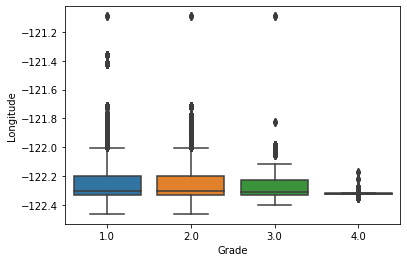

In [35]:
sns.boxplot(data=df_cleaned,x = "Grade" , y = "Longitude")

<AxesSubplot:xlabel='Grade', ylabel='Latitude'>

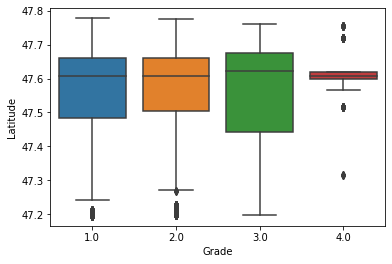

In [36]:
sns.boxplot(data=df_cleaned,x = "Grade" , y = "Latitude")

<AxesSubplot:xlabel='Grade', ylabel='Inspection Score'>

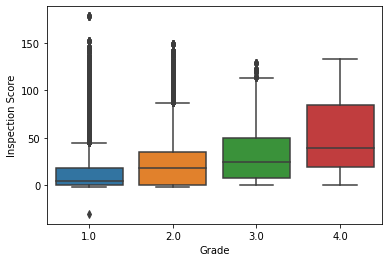

In [37]:
sns.boxplot(data=df_cleaned,x = "Grade" , y = "Inspection Score")

<AxesSubplot:xlabel='Grade', ylabel='Violation Points'>

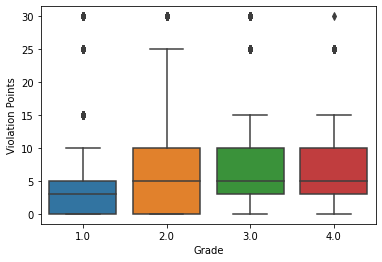

In [38]:
sns.boxplot(data=df_cleaned,x = "Grade" , y = "Violation Points")

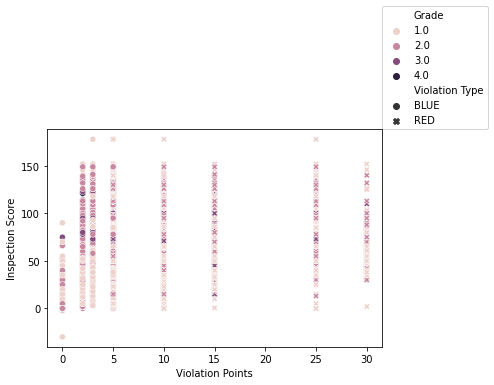

In [39]:
fig , ax = plt.subplots(1,1)
ax = sns.scatterplot(data= df_cleaned , x = "Violation Points" , y = "Inspection Score",  hue = "Grade",style= "Violation Type")
ax.legend(loc = (1,1));

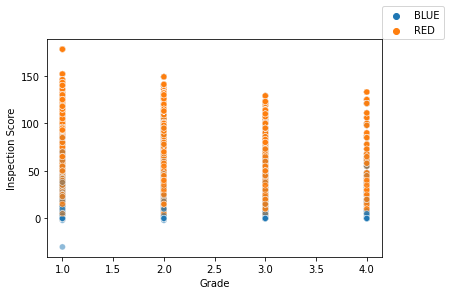

In [40]:
fig , ax = plt.subplots(1,1)
ax = sns.scatterplot(data= df_cleaned , y = "Inspection Score",  x = "Grade",hue= "Violation Type",alpha=0.5)
ax.legend(loc = (1,1));

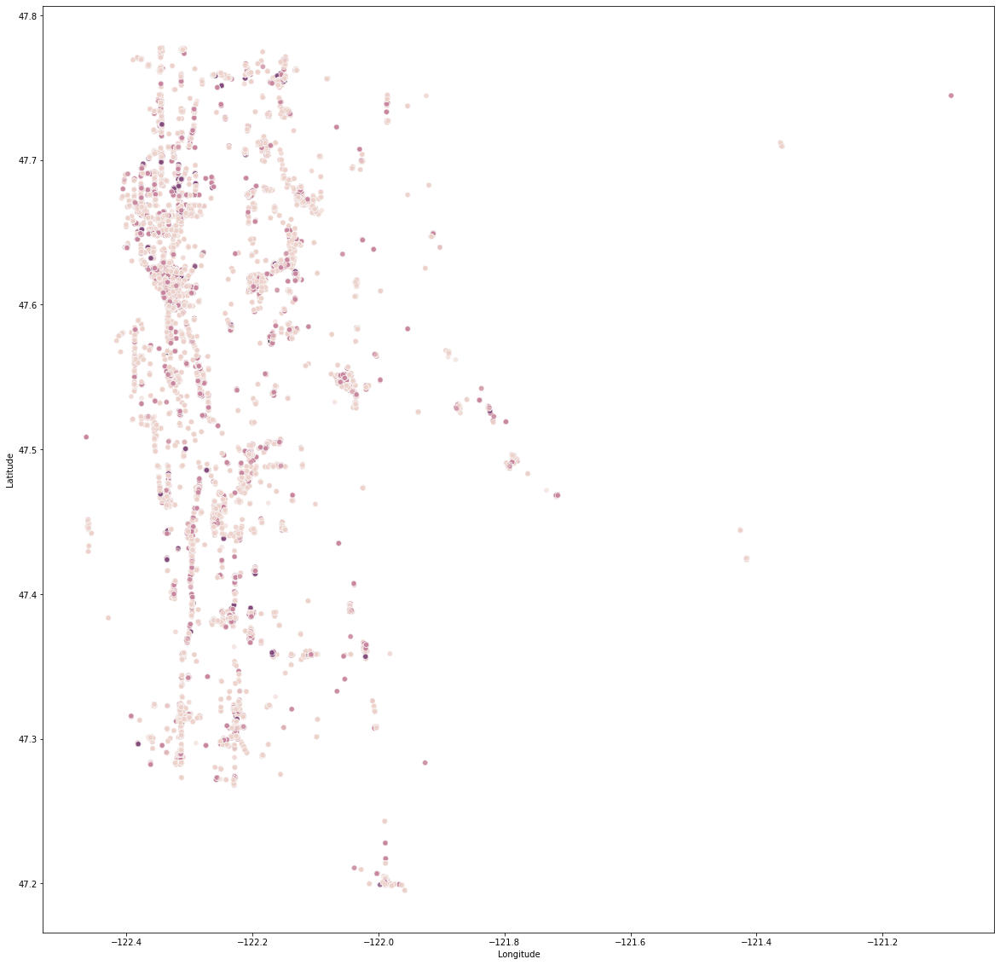

In [41]:
fig , ax = plt.subplots(1,1,figsize = (20,20))
ax = sns.scatterplot(data= df_cleaned , y = "Latitude",  x = "Longitude",hue= "Grade",alpha=0.5,legend=False)
# ax.legend.remove()


### Filling Description missing values

In [62]:
df_cleaned[df_cleaned["Description"].str.endswith("plumbing")]

,Name,Program Identifier,Inspection Date,Description,Address,City,Zip Code,Longitude,Latitude,Inspection Business Name,Inspection Type,Inspection Score,Inspection Result,Inspection Closed Business,Violation Type,Violation Description,Violation Points,Business_ID,Inspection_Serial_Num,Grade
4481,ACCESSO SHOWARE CENTER,ShoWare Center - Portable Club Bar,11/30/2021,Limited Food Services - no permanent plumbing,625 W JAMES ST,KENT,98032,-122.240084,47.387861,ACCESSO SHOWARE CENTER,Routine Inspection/Field Review,0.0,Satisfactory,False,BLUE,NaN,0,PR0077849,DAEFKY3BY,NaN
4483,ACCESSO SHOWARE CENTER,ShoWare Center - Coffee & Bakery,11/30/2021,Limited Food Services - no permanent plumbing,625 W JAMES ST,KENT,98032,-122.240084,47.387861,ACCESSO SHOWARE CENTER,Routine Inspection/Field Review,0.0,Satisfactory,False,BLUE,NaN,0,PR0077816,DAJYAGKAX,NaN
4490,ACCESSO SHOWARE CENTER,ShoWare Center - Coffee & Bakery,10/11/2019,Limited Food Services - no permanent plumbing,625 W JAMES ST,KENT,98032,-122.240084,47.387861,ACCESSO SHOWARE CENTER,Routine Inspection/Field Review,0.0,Satisfactory,False,BLUE,NaN,0,PR0077816,DA0W0F0FZ,NaN
4492,ACCESSO SHOWARE CENTER,ShoWare Center - Portable Club Bar,10/11/2019,Limited Food Services - no permanent plumbing,625 W JAMES ST,KENT,98032,-122.240084,47.387861,ACCESSO SHOWARE CENTER,Routine Inspection/Field Review,0.0,Satisfactory,False,BLUE,NaN,0,PR0077849,DA4K1BAD0,NaN
4497,ACCESSO SHOWARE CENTER,ShoWare Center - Coffee & Bakery,07/29/2018,Limited Food Services - no permanent plumbing,625 W JAMES ST,KENT,98032,-122.240084,47.387861,ACCESSO SHOWARE CENTER,Routine Inspection/Field Review,0.0,Satisfactory,False,BLUE,NaN,0,PR0077816,DACNFTABZ,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
247241,WIRED CHICK'S ESPRESSO,WIRED CHICK'S ESPRESSO,09/30/2015,Limited Food Services - no permanent plumbing,16827 BOTHELL WAY NE,LAKE FOREST PARK,98155,-122.281882,47.751587,WIRED CHICK'S ESPRESSO,Routine Inspection/Field Review,0.0,Satisfactory,False,BLUE,NaN,0,PR0031730,DABA1YNAX,NaN
247242,WIRED CHICK'S ESPRESSO,WIRED CHICK'S ESPRESSO,11/06/2014,Limited Food Services - no permanent plumbing,16827 BOTHELL WAY NE,LAKE FOREST PARK,98155,-122.281882,47.751587,WIRED CHICK'S ESPRESSO,Routine Inspection/Field Review,0.0,Satisfactory,False,BLUE,NaN,0,PR0031730,DA2557457,NaN
247243,WIRED CHICK'S ESPRESSO,WIRED CHICK'S ESPRESSO,02/06/2013,Limited Food Services - no permanent plumbing,16827 BOTHELL WAY NE,LAKE FOREST PARK,98155,-122.281882,47.751587,WIRED CHICK'S ESPRESSO,Routine Inspection/Field Review,10.0,Unsatisfactory,False,RED,0600 - Adequate handwashing facilities,10,PR0031730,DA2412133,NaN
247244,WIRED CHICK'S ESPRESSO,WIRED CHICK'S ESPRESSO,01/31/2012,Limited Food Services - no permanent plumbing,16827 BOTHELL WAY NE,LAKE FOREST PARK,98155,-122.281882,47.751587,WIRED CHICK'S ESPRESSO,Routine Inspection/Field Review,25.0,Satisfactory,False,RED,0400 - Hands washed as required,15,PR0031730,DA2301256,NaN


In [66]:
df_cleaned["Category"] = df_cleaned.loc[:, "Description"].apply(lambda x: {"I":1 , "II":2 ,"III":3 , "plumbing":0}[x.split("-")[-1].split(" ")[-1]])

In [67]:
df_cleaned

,Name,Program Identifier,Inspection Date,Description,Address,City,Zip Code,Longitude,Latitude,Inspection Business Name,...,Inspection Score,Inspection Result,Inspection Closed Business,Violation Type,Violation Description,Violation Points,Business_ID,Inspection_Serial_Num,Grade,Category
0,#807 TUTTA BELLA,#807 TUTTA BELLA,08/31/2022,Seating 0-12 - Risk Category III,2746 NE 45TH ST,SEATTLE,98105,-122.296415,47.662311,#807 TUTTA BELLA,...,10.0,Unsatisfactory,False,BLUE,"3200 - Insects, rodents, animals not present; ...",5,PR0089260,DAEEWQC0L,1.0,3
1,#807 TUTTA BELLA,#807 TUTTA BELLA,08/31/2022,Seating 0-12 - Risk Category III,2746 NE 45TH ST,SEATTLE,98105,-122.296415,47.662311,#807 TUTTA BELLA,...,10.0,Unsatisfactory,False,RED,0200 - Food Worker Cards current for all food ...,5,PR0089260,DAEEWQC0L,1.0,3
2,#807 TUTTA BELLA,#807 TUTTA BELLA,01/13/2022,Seating 0-12 - Risk Category III,2746 NE 45TH ST,SEATTLE,98105,-122.296415,47.662311,#807 TUTTA BELLA,...,0.0,Satisfactory,False,BLUE,NaN,0,PR0089260,DAWWGK08K,1.0,3
3,#807 TUTTA BELLA,#807 TUTTA BELLA,01/06/2021,Seating 0-12 - Risk Category III,2746 NE 45TH ST,SEATTLE,98105,-122.296415,47.662311,#807 TUTTA BELLA,...,0.0,Satisfactory,False,BLUE,NaN,0,PR0089260,DAUHM2FT8,1.0,3
4,+MAS CAFE,+MAS CAFE,07/13/2022,Seating 0-12 - Risk Category III,1906 N 34TH ST,SEATTLE,98103,-122.334587,47.648180,+MAS CAFE,...,0.0,Satisfactory,False,BLUE,NaN,0,PR0046367,DATSWIPUS,2.0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
250753,ZYLBERSCHTEIN'S DELICATESSEN & BAKERY,ZYLBERSCHTEIN'S DELICATESSEN & BAKERY,11/21/2018,Seating 0-12 - Risk Category III,11752 15TH AVE NE,SEATTLE,98125,-122.312056,47.715359,ZYLBERSCHTEIN'S DELICATESSEN & BAKERY,...,0.0,Complete,False,BLUE,NaN,0,PR0086991,DAJ0G4RNT,2.0,3
250754,ZYLBERSCHTEIN'S DELICATESSEN & BAKERY,ZYLBERSCHTEIN'S DELICATESSEN & BAKERY,05/09/2018,Seating 0-12 - Risk Category III,11752 15TH AVE NE,SEATTLE,98125,-122.312056,47.715359,ZYLBERSCHTEIN'S DELICATESSEN & BAKERY,...,0.0,Satisfactory,False,BLUE,NaN,0,PR0086991,DASIXMJAV,2.0,3
250755,ZYLBERSCHTEIN'S DELICATESSEN & BAKERY,ZYLBERSCHTEIN'S DELICATESSEN & BAKERY,11/27/2017,Seating 0-12 - Risk Category III,11752 15TH AVE NE,SEATTLE,98125,-122.312056,47.715359,ZYLBERSCHTEIN'S DELICATESSEN & BAKERY,...,0.0,Satisfactory,False,BLUE,NaN,0,PR0086991,DA3OGNCPY,2.0,3
250756,ZYLBERSCHTEIN'S DELICATESSEN & BAKERY,ZYLBERSCHTEIN'S DELICATESSEN & BAKERY,09/06/2017,Seating 0-12 - Risk Category III,11752 15TH AVE NE,SEATTLE,98125,-122.312056,47.715359,ZYLBERSCHTEIN'S DELICATESSEN & BAKERY,...,0.0,Complete,False,BLUE,NaN,0,PR0086991,DALIX7JOT,2.0,3


In [96]:
cross_tab = pd.crosstab(index= df_cleaned.Grade , columns=df_cleaned.Category,normalize=False)

In [97]:
cross_tab

Category,1,2,3
Grade,,,
1.0,5500,13115,108457
2.0,743,1624,53192
3.0,73,131,7663
4.0,5,0,535


In [98]:
_ , p_value , dof , expeted_values = chi2_contingency(cross_tab)

In [99]:
p_value

0.0

In [100]:
expeted_values

array([[4.20451487e+03, 9.89101980e+03, 1.12976465e+05],
       [1.83831719e+03, 4.32459683e+03, 4.93960860e+04],
       [2.60300605e+02, 6.12350894e+02, 6.99434850e+03],
       [1.78673353e+01, 4.20324752e+01, 4.80100189e+02]])

<AxesSubplot:xlabel='Category', ylabel='Inspection Score'>

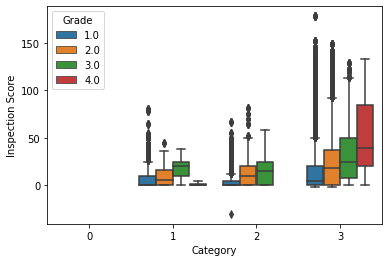

In [102]:
sns.boxplot(data=df_cleaned , x = "Category" , y = "Inspection Score" , hue= "Grade")

<AxesSubplot:xlabel='Grade', ylabel='Category-Violation Type'>

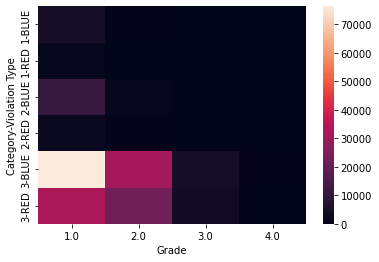

In [108]:
sns.heatmap(pd.crosstab(index= [df_cleaned.Category , df_cleaned["Violation Type"]] ,columns=df_cleaned.Grade ,normalize=False))

In [109]:
### fill values with grade 1

In [ ]:
df_cleaned["Grade"].fillna()

In [146]:
q1 = np.quantile(df_cleaned["Inspection Score"],0.25)
q2 = np.quantile(df_cleaned["Inspection Score"],0.5)
q3 = np.quantile(df_cleaned["Inspection Score"],0.75)
def Inspection_Score_InRange_Categorizer( x) :
    if x <q1:
        return 0
    elif x <q2:
        return 1
    elif x <q3 :
        return 2
    else: return 3

In [148]:
Inspection_Score_InRange_Categorizer( 233)

3

In [149]:
df_cleaned["Inspection_Score_InRange"] = df_cleaned["Inspection Score"].apply(lambda x:Inspection_Score_InRange_Categorizer(x))

In [151]:
d = pd.crosstab(index=[df_cleaned["Inspection Closed Business"],df_cleaned["Inspection_Score_InRange"] , df_cleaned["Violation Type"]],columns=df_cleaned.Grade)

In [152]:
d

Grade                                                                 1.0  \
Inspection Closed Business Inspection_Score_InRange Violation Type          
False                      0                        BLUE                4   
                           1                        BLUE            59874   
                                                    RED                16   
                           2                        BLUE            20271   
                                                    RED             16043   
                           3                        BLUE            11834   
                                                    RED             18772   
True                       1                        BLUE               10   
                           2                        BLUE                2   
                                                    RED                 5   
                           3                        BLUE               68   
                                                    RED               173   

Grade                                                                 2.0  \
Inspection Closed Business Inspection_Score_InRange Violation Type          
False                      0                        BLUE                1   
                           1                        BLUE            15194   
                                                    RED                 0   
                           2                        BLUE             6910   
                                                    RED              6280   
                           3                        BLUE            10640   
                                                    RED             16300   
True                       1                        BLUE                6   
                           2                        BLUE                1   
                                                    RED                 2   
                           3                        BLUE               92   
                                                    RED               133   

Grade                                                                3.0  4.0  
Inspection Closed Business Inspection_Score_InRange Violation Type             
False                      0                        BLUE               0    0  
                           1                        BLUE            1629   80  
                                                    RED                3    0  
                           2                        BLUE             865   29  
                                                    RED              674   24  
                           3                        BLUE            1898  163  
                                                    RED             2773  152  
True                       1                        BLUE               0    2  
                           2                        BLUE               0    0  
                                                    RED                0    2  
                           3                        BLUE               8   40  
                                                    RED               17   48

In [154]:
df_cleaned["Grade"].fillna(1,inplace=True)

In [158]:
df_cleaned = df_cleaned.drop(["Violation Description" , "Business_ID" , "Inspection_Serial_Num" ,"Inspection_Score_InRange", "Address" ,"Zip Code", "Inspection Business Name" ,"Program Identifier"],axis=1)

In [160]:
df_cleaned.to_csv("cleaned_dataset_V1.csv", header=True , index=False)